# Create xView background images

It'll be a little slow... but here we go. 

Want a function to plot the figures with bounding box around the eligible 'background'
Then another function to crop that part using the same bb arguments

In [1]:
import aug_util as aug
import wv_util as wv
import matplotlib.pyplot as plt
import numpy as np
import csv
import os
import glob
from PIL import Image, ImageDraw
%matplotlib inline

In [2]:
def draw_metadata_bboxes(im,boxes):
    """
    A helper function to draw bounding box rectangles on images

    Args:
        img: image to be drawn on in array format
        boxes: An (N,4) array of bounding boxes
            boxes[:,0] = upper-left normalized x-value 
            boxes[:,1] = upper-left normalized y-value
            boxes[:,2] = bottom-right normalized x-value
            boxes[:,3] = bottom-right normalized y-value

    Output:
        Image with drawn bounding boxes
    """
    #im = Image.open(img_file_loc)
    draw = ImageDraw.Draw(im)
    im_w, im_h = im.size

    idx = 0

    for b in boxes:
        x,y,xx,yy = b
        x_pix = int(float(x)*im_w)
        y_pix = int(float(y)*im_h)
        xx_pix = int(float(xx)*im_w)
        yy_pix = int(float(yy)*im_h)

        draw.rectangle(((x_pix, y_pix), (xx_pix, yy_pix)), outline="red", width=2)
    return im

In [3]:
def crop_tif(tif_path, boxes, save_path='/home/physicsai/sim2real/data/xview/created_background_imgs/'):
    """
    Function to save background crops
    """

    im = Image.open(tif_path)
    draw = ImageDraw.Draw(im)
    im_w, im_h = im.size

    idx = 0

    for b in boxes:
        x,y,xx,yy = b
        x_pix = int(float(x)*im_w)
        y_pix = int(float(y)*im_h)
        xx_pix = int(float(xx)*im_w)
        yy_pix = int(float(yy)*im_h)

    return im.crop((x_pix, y_pix, xx_pix, yy_pix))

In [83]:
tif_folder = '/home/physicsai/sim2real/data/xview/val_images/'
tif_num = '2622'
tif_path = tif_folder+tif_num+'.tif'
im = Image.open(tif_path)
bb = [[0.24,0.5,0.49,1]]

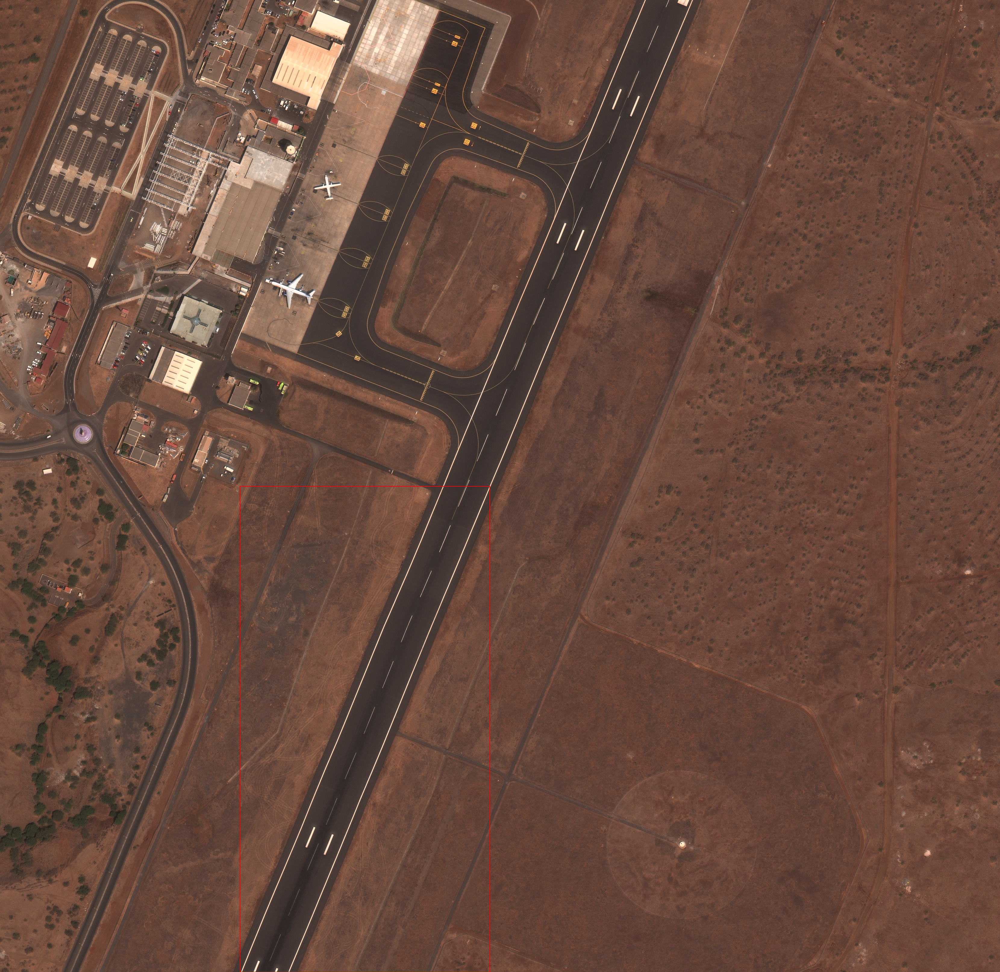

In [84]:
draw_metadata_bboxes(im, bb)

### take same input and crop image and save

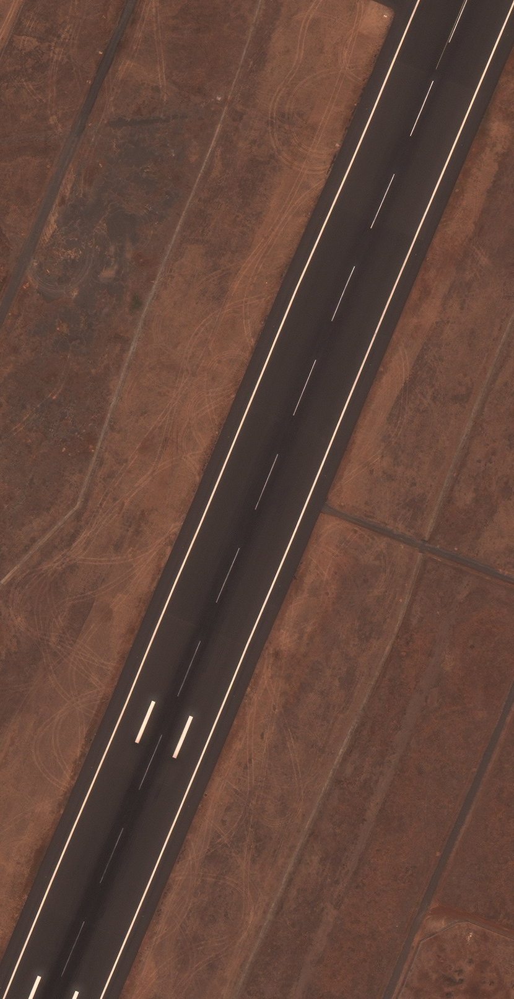

In [85]:
im_out = crop_tif(tif_path, boxes=bb)
im_out

In [86]:
saved_crops = glob.glob("/home/physicsai/sim2real/data/xview/created_background_imgs/*.jpg")
num_saved_crops = len(saved_crops)
save_path = "/home/physicsai/sim2real/data/xview/created_background_imgs/frame%s-%04d.jpg"%(tif_num,num_saved_crops)
print(save_path)

/home/physicsai/sim2real/data/xview/created_background_imgs/frame2622-0202.jpg


In [87]:
im_out.save(fp=save_path)

In [41]:
import random

In [46]:
a = 0.1+np.zeros((5,5,3,5+1))
for i in range(a.shape[0]):
    for j in range(a.shape[1]):
        for k in range(a.shape[2]):
            for l in range(a.shape[3]):
                a[i][j][k][l] += 5*np.random.binomial(n=1,p=0.1)
a

array([[[[0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 5.1, 0.1]],

        [[0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 5.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]],

        [[0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]],

        [[0.1, 5.1, 5.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]],

        [[0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 5.1, 0.1, 0.1]]],


       [[[0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 5.1, 0.1, 0.1, 0.1, 0.1],
         [5.1, 0.1, 0.1, 0.1, 0.1, 0.1]],

        [[0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 5.1, 0.1, 0.1, 0.1],
         [0.1, 5.1, 0.1, 0.1, 0.1, 0.1]],

        [[0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 0.1],
         [0.1, 0.1, 0.1, 0.1, 0.1, 5.1]],

In [53]:
b = a[...,4:5]
b

mask = np.equal(b,5.1).astype(int)
a*mask

array([[[[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0.1, 0.1, 0.1, 0.1, 5.1, 0.1]],

        [[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ]],

        [[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ]],

        [[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ]],

        [[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ]]],


       [[[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ]],

        [[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ]],

        [[0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ],
         [0. , 0. , 0. , 0. , 0. , 0. ]],